In [3]:
import pandas as pd
import numpy as np
from IPython.display import HTML
import re
import glob
from pandas_profiling import ProfileReport
import matplotlib.pyplot as plt
import seaborn as sns
from pathlib import Path

In [4]:
path = Path("Data-mining")

In [5]:
print(path)

Data-mining


In [6]:
path/"Data/Kenyanpaper2.csv"

PosixPath('Data-mining/Data/Kenyanpaper2.csv')

In [7]:
# grab all the CSV files of interest with a wildcard
csv_file_list = glob.glob("Data-mining/Data/Kenyapaper*.csv")

# show the result
print(csv_file_list)

[]


In [8]:
# make an empty list
dataframe_list = []

# loop through each filename, read in all the files and add it onto the empty list.
# this returns a list of dataframes
for filename in csv_file_list:
    data = pd.read_csv(filename, sep = "\t")
    dataframe_list.append(data)

# bring the list of dataframes to be one dataframe
#pd.concat(dataframe_list, sort=False)

In [9]:
#dataframe_list[1]

In [10]:
# load dataframe separated by spaces
authors = pd.read_csv("../Data/Kenyapapers.csv", sep = "\t")

# what are the column names
authors.columns

Index(['title', 'year', 'journal', 'lastname', 'firstname', 'address', 'email',
       'pmid', 'month', 'day'],
      dtype='object')

In [11]:
authors

,title,year,journal,lastname,firstname,address,email,pmid,month,day
0,Current Trends of Nanobiosensors for Point-of-...,2019.0,Journal of analytical methods in chemistry,Noah,Naumih M,"School of Pharmacy and Health Sciences, United...",NaN,31886019,1.0,1.0
1,Current Trends of Nanobiosensors for Point-of-...,2019.0,Journal of analytical methods in chemistry,Ndangili,Peter M,Department of Chemical Science and Technology ...,NaN,31886019,1.0,1.0
2,"Efficacy of Ivermectin, Liquid Paraffin, and C...",2019.0,Journal of tropical medicine,Ogolla,Kennedy O,"Department of Veterinary Pathology, Microbiolo...",NaN,31885634,1.0,1.0
3,"Efficacy of Ivermectin, Liquid Paraffin, and C...",2019.0,Journal of tropical medicine,Chebet,Joyce,"Department of Veterinary Pathology, Microbiolo...",NaN,31885634,1.0,1.0
4,"Efficacy of Ivermectin, Liquid Paraffin, and C...",2019.0,Journal of tropical medicine,Waruiru,Robert M,"Department of Veterinary Pathology, Microbiolo...",NaN,31885634,1.0,1.0
...,...,...,...,...,...,...,...,...,...,...
74186,Distribution of biomass of species differing i...,1980.0,Oecologia,Boutton,Thomas W,"Department of Botany and Range Science, Brigha...",NaN,28309553,1.0,1.0
74187,Distribution of biomass of species differing i...,1980.0,Oecologia,Harrison,A Tyrone,"School of Life Sciences, University of Nebrask...",NaN,28309553,1.0,1.0
74188,Distribution of biomass of species differing i...,1980.0,Oecologia,Smith,Bruce N,"Department of Botany and Range Science, Brigha...",NaN,28309553,1.0,1.0
74189,The effects of wind and temperature on cuticul...,1980.0,Oecologia,Baig,M N,"Dept of Botany, University of Nairobi, P.O. Bo...",NaN,28309479,1.0,1.0


In [12]:
# convert each item in the column with lastname and firstname
def join_names(x): return str(x["lastname"]) + " " + str(x["firstname"])


# apply function to the dataset
authors["allauthors"] = authors.apply(join_names, axis = 1)

In [13]:
# join the author names together
def join_names(x): return str(x["lastname"]) + " " + str(x["firstname"]) + " " + str(x["address"])

# apply function to the dataset
authors["allauthorsinstitutions"] = authors.apply(join_names, axis = 1)

In [55]:
# set the index to be the title and pmid
author_indexes = authors.set_index(["title", "pmid"])

# take only the columns of interest
author_collab = author_indexes[["allauthors", "allauthorsinstitutions"]]

# see the first columns
HTML(author_collab.to_html())

In [13]:
# convert dataframe into a html summary statistics report
profile = ProfileReport(author_collab)

# take the html and save it onto a file
#profile.to_file(output_file="output_author+institution.html") # renamed at the moment

In [15]:
# convert the profile object into ipywidgets object
profile.to_widgets() 

In [ ]:
profile.to_notebook_iframe()

# Common authors 

Before trying to answers are the authors collaboration within or without. Let see who are most common authors:

Marsh kevin 

Snow Robert W

Bukusi Elizabeth A

English Mike

Berkley James A 

Cohen Craig R

Baeten Jared M

Scott J Anthony G

John-Stewart Grace

Breiman Robert F 

# Common authors + institutions
Gives us a clue which institutions are collaborating and common authors

Moloo S K International Laboratory for Research on Animal Diseases (ILRAD), Nairobi, Kenya 	 	
 
Plummer F A Department of Medical Microbiology, University of Nairobi, Kenya 		
 
Agot Kawango Impact Research and Development Organization, Kisumu, Kenya 	 	
 
Kyobutungi Catherine African Population and Health Research Center, Nairobi, Kenya 		
 
Ndinya-Achola J O Department of Medical Microbiology, University of Nairobi, Kenya 		
 
Grace Delia International Livestock Research Institute, Nairobi, Kenya 		
 
Kariuki Samuel Centre for Microbiology Research, Kenya Medical Research Institute, Nairobi, Kenya 		
 
Scott J Anthony G Kenya Medical Research Institute-Wellcome Trust Research Programme, Kilifi 		
 
Owiti P Academic Model Providing Access to Healthcare (AMPATH), Eldoret, Kenya 	

Morrison W I International Laboratory for Research on Animal Diseases, Nairobi, Kenya 

In [ ]:
# subset the dataframe to see who are the collaborators of the most common institutions
# then see if the associated institutions are from outside in the address or inside 
# in code take the name of the user e.g Owiti P filter the all authors to have that name then look at the
# transposed data and look at the authors that collaborated with the person and the column address 

In [16]:
def show_collabs_prob (aut_name):
    '''
    Subsets a dataframe based on the name given and returns a Pandas Series with a probability of seeing that name, institution combination
    
    Args:
    aut_name this is the name of the author which is a string.
    '''
    find_collab = author_collab[author_collab.allauthors == aut_name]
    find_collab = find_collab["allauthorsinstitutions"].value_counts(normalize=True)
    return find_collab

show_collabs_prob("John-Stewart Grace")

John-Stewart Grace Department of Global Health, University of Washington, Seattle, WA, USA                                                                                                                                                                                                                                                                                                                                  0.049505
John-Stewart Grace Department of Global Health, University of Washington, Seattle, Washington, USA                                                                                                                                                                                                                                                                                                                          0.039604
John-Stewart Grace Department of Global Health, University of Washington, Seattle, USA                                                                        

As for the common authors

The trend from the sample that looks into the most common author and institution is that the authors mostly do research and collaborate in departments within the organization/research institute. Fewer external collaborations from the table in Notebooks/Collaboration_trends.ipynb. In numbers about 29 institutions in Kenya and about 18 foreign. In addition, JKUAT has the least collaborations with the top institutions from this list except with KEMRI.

When looking at individual authors the trend is some authors are associated with certain institutions. Also, there are some who mostly collaborate outside additionally like in the previous group mostly internally within the organization/Institutes in different departments. On a side note, they have been only 3 publications related to Machine learning or complex statistical modeling within the time of study explicitly mentioned.

This is an experiment to look into interactions using graph theory. It needs more work.

## Drawing Plots

## Common authors

NB: Notice that the collaboration has been appended close to the name of the author

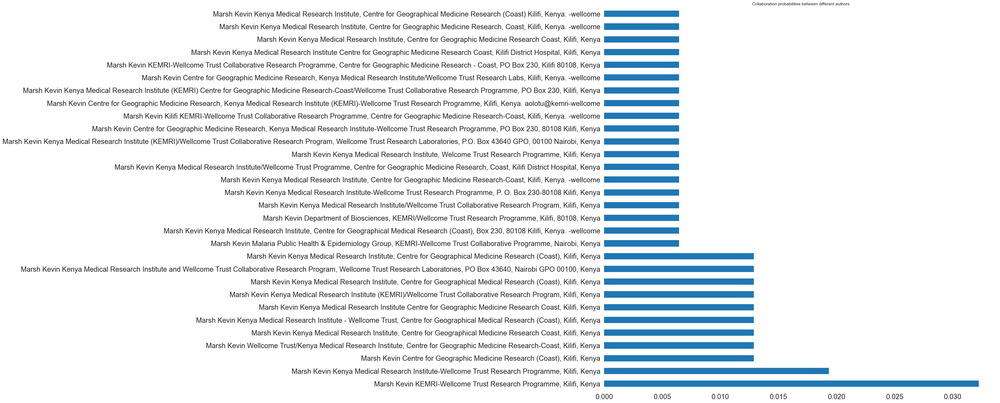

In [17]:
def show_collabs_prob (aut_name, figsize = (20,20), fontsize= 20):
    '''
    Subsets a dataframe based on the name given and returns a Pandas Series with a probability of seeing that name, institution combination
    It then plots it in a horizontal bar graph
    
    Args:
    aut_name this is the name of the author which is a string.
    '''
    find_collab = author_collab[author_collab.allauthors == aut_name]
    find_collab = find_collab["allauthorsinstitutions"].value_counts(normalize=True)[:30]
    return find_collab.plot(kind = "barh", title = "Collaboration probabilities between different authors", figsize = figsize, fontsize = fontsize)
    

show_collabs_prob("Marsh Kevin")

In [18]:
show_collabs_prob("Bukusi Elizabeth A", figsize=(80, 75), fontsize=90) 

In [ ]:
show_collabs_prob("Snow Robert W") 

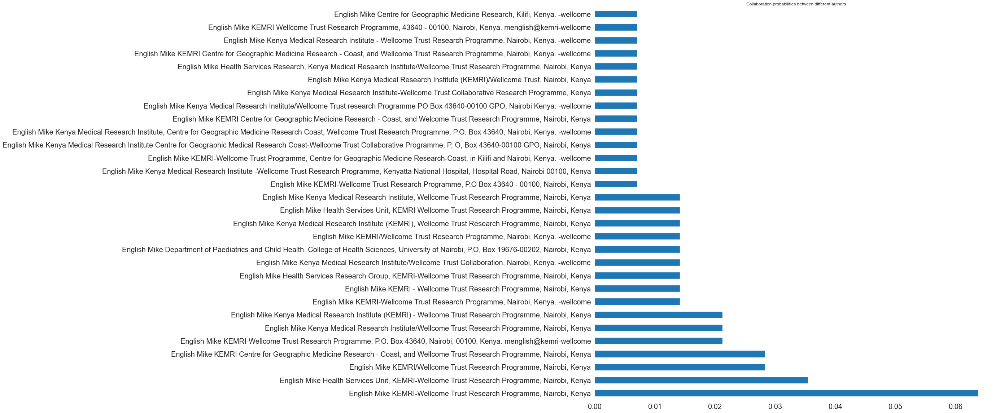

In [19]:
show_collabs_prob("English Mike") 

In [ ]:
show_collabs_prob("Berkley James A")

In [ ]:
show_collabs_prob("Cohen Craig R",figsize=(80, 75), fontsize=90)

In [ ]:
show_collabs_prob("Baeten Jared M", figsize=(80, 75), fontsize=90)

In [ ]:
show_collabs_prob("Scott J Anthony G")

In [ ]:
show_collabs_prob("John-Stewart Grace", figsize=(80, 75), fontsize=90)

In [ ]:
show_collabs_prob("Breiman Robert F")

# Common author + institutions

AxesSubplot(0.125,0.125;0.775x0.755)


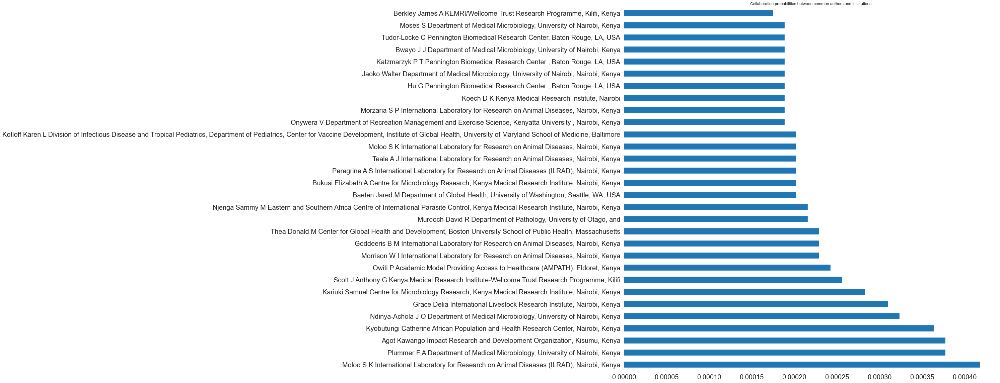

In [20]:
def show_collabs_prob2 (aut_name,sample_size, figsize = (20,20), fontsize = 20):
    '''
    Subsets a dataframe based on the name given and returns a Pandas Series with a probability of seeing that name, institution combination
    It then plots it in a horizontal bar graph
    
    Args:
    aut_name this is the name of the author which is a string.
    samp_size this is the number of rows to sample out of.
    '''
    find_collab = author_collab[author_collab.allauthorsinstitutions == aut_name]
    find_collab = author_collab["allauthorsinstitutions"].value_counts(normalize=True)[:sample_size]
    return find_collab.plot(kind = "barh", title = "Collaboration probabilities between common authors and institutions", figsize = figsize, fontsize = fontsize)


auth1 = show_collabs_prob2("Moloo S K International Laboratory for Research on Animal Diseases (ILRAD), Nairobi, Kenya", 30)
print(auth1)

In [ ]:
auth2 = show_collabs_prob2("Plummer F A Department of Medical Microbiology, University of Nairobi, Kenya", sample_size=28)
print(auth2)

In [ ]:
show_collabs_prob2("Agot Kawango Impact Research and Development Organization, Kisumu, Kenya", sample_size=28)

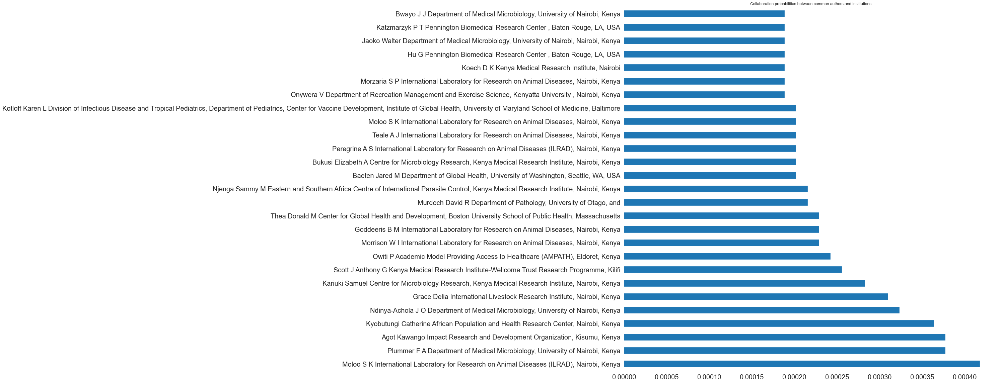

In [21]:
show_collabs_prob2("Kyobutungi Catherine African Population and Health Research Center, Nairobi, Kenya", sample_size=27)

In [ ]:
show_collabs_prob2("Ndinya-Achola J O Department of Medical Microbiology, University of Nairobi, Kenya",sample_size=24)

In [ ]:
show_collabs_prob2("Grace Delia International Livestock Research Institute, Nairobi, Kenya", sample_size=23)

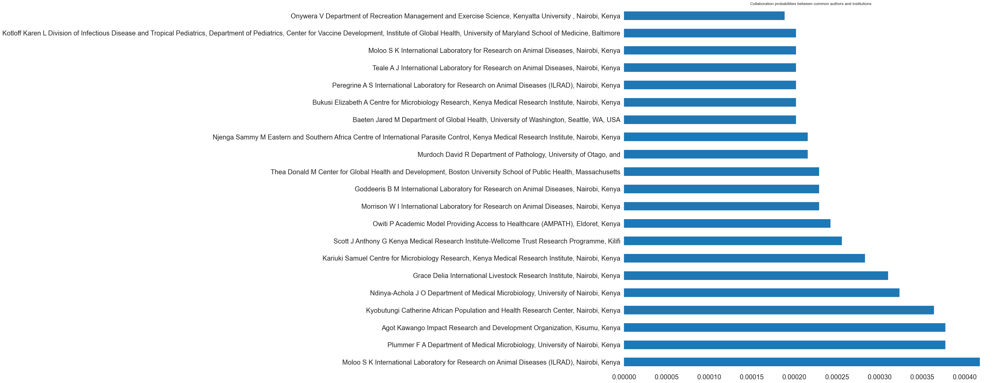

In [22]:
show_collabs_prob2("Kariuki Samuel Centre for Microbiology Research, Kenya Medical Research Institute, Nairobi, Kenya", sample_size=21)

In [ ]:
show_collabs_prob2("Scott J Anthony G Kenya Medical Research Institute-Wellcome Trust Research Programme, Kilifi", sample_size=19)

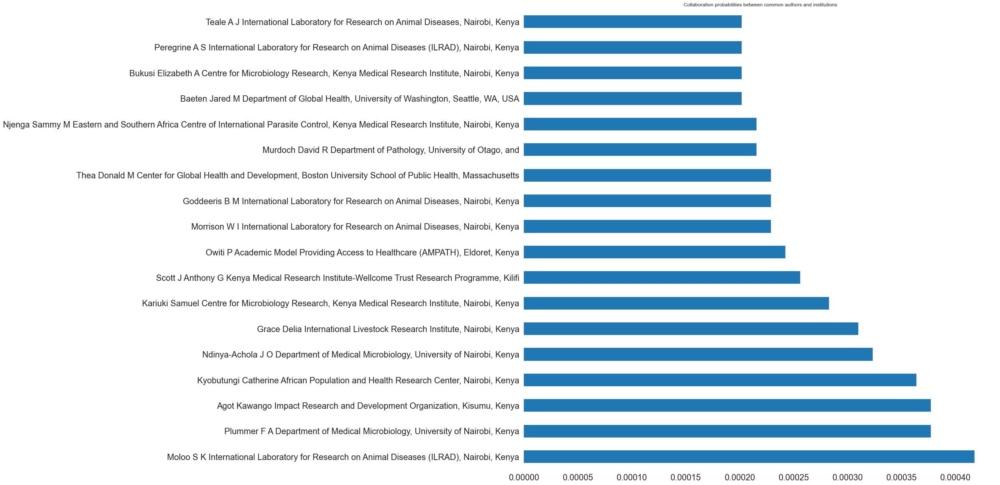

In [23]:
show_collabs_prob2("Owiti P Academic Model Providing Access to Healthcare (AMPATH), Eldoret, Kenya", sample_size=
                   18)

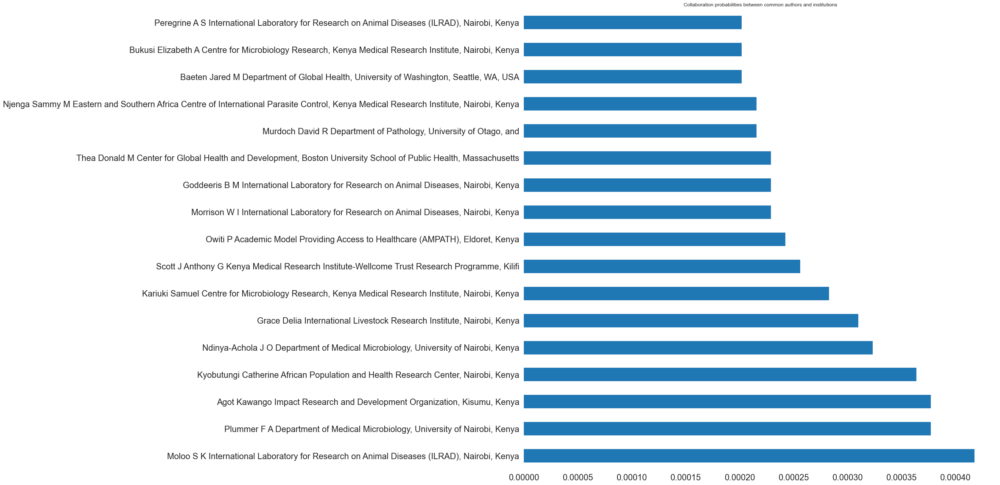

In [24]:
show_collabs_prob2("Morrison W I International Laboratory for Research on Animal Diseases, Nairobi, Kenya",sample_size=17)

# Drawing graphs 

Simply using graph (node + vertices) to reveal any trend in collaboration between the authors. Are they collaborating from within or without. The previous method we used was simply sampling but let's see if this will hold when looking at graphs. The first thing is to design the graph using pen and paper. We'll skip that step. Here, I chose to use the pmid which was unique per publication and also tied to the author or authors of the publication. In short, the pmid is associated with some title of a publication which is written by some authors. This can be represented as:

pmid -> author or authors 

In [ ]:
author/authors -> pmid

In other words, several authors wrote a publication that was generated a specific pmid. 

In [ ]:
# what variables are loaded

In [14]:
whos

Variable         Type         Data/Info
---------------------------------------
HTML             type         <class 'IPython.core.display.HTML'>
Path             type         <class 'pathlib.Path'>
ProfileReport    type         <class 'pandas_profiling.ProfileReport'>
authors          DataFrame                             <...>[74191 rows x 12 columns]
csv_file_list    list         n=0
dataframe_list   list         n=0
glob             module       <module 'glob' from '/Use<...>3/lib/python3.6/glob.py'>
join_names       function     <function join_names at 0x1204bf158>
json             module       <module 'json' from '/Use<...>hon3.6/json/__init__.py'>
lib2to3          module       <module 'lib2to3' from '/<...>3.6/lib2to3/__init__.py'>
np               module       <module 'numpy' from '/Us<...>kages/numpy/__init__.py'>
path             PosixPath    Data-mining
pd               module       <module 'pandas' from '/U<...>ages/pandas/__init__.py'>
plt              module       <module

In [17]:
from sklearn import preprocessing

# initialise the label Encoder object
le = preprocessing.LabelEncoder()

# fit and transform the names found the all authors column to a numbers
author_collab["num_label"] = le.fit_transform(author_collab.allauthors.values)

/Users/aoi-rain/miniconda3/lib/python3.6/site-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys


In [18]:
# confirmation that it has worked
author_collab.head()

allauthors  \
title                                              pmid                         
Current Trends of Nanobiosensors for Point-of-C... 31886019     Noah Naumih M   
                                                   31886019  Ndangili Peter M   
Efficacy of Ivermectin, Liquid Paraffin, and Ca... 31885634  Ogolla Kennedy O   
                                                   31885634      Chebet Joyce   
                                                   31885634  Waruiru Robert M   

                                                                                        allauthorsinstitutions  \
title                                              pmid                                                          
Current Trends of Nanobiosensors for Point-of-C... 31886019  Noah Naumih M School of Pharmacy and Health Sc...   
                                                   31886019  Ndangili Peter M Department of Chemical Scienc...   
Efficacy of Ivermectin, Liquid Paraffin, and Ca... 31885634  Ogolla Kennedy O Department of Veterinary Path...   
                                                   31885634  Chebet Joyce Department of Veterinary Patholog...   
                                                   31885634  Waruiru Robert M Department of Veterinary Path...   

                                                             num_label  
title                                              pmid                 
Current Trends of Nanobiosensors for Point-of-C... 31886019      20756  
                                                   31886019      19521  
Efficacy of Ivermectin, Liquid Paraffin, and Ca... 31885634      22046  
                                                   31885634       3890  
                                                   31885634      30416

In [19]:
# remove the current index
all_author_collab = author_collab.reset_index()

# subset the pmid and num label columns from the dataframe
all_author_collab = all_author_collab[["pmid", "num_label"]]

In [20]:
# adjust the number of rows that can be shown
# look at documentation to fix this
pd.set_option('display.max_rows', 1000)

In [21]:
# see the dataframe object
# convert to a horizontal dataframe
all_author_collab.transpose()

,0,1,2,3,4,5,6,7,8,9,...,74181,74182,74183,74184,74185,74186,74187,74188,74189,74190
pmid,31886019,31886019,31885634,31885634,31885634,31885634,31885634,31885634,31885453,31883526,...,28309458,22065665,15615049,15615049,15615049,28309553,28309553,28309553,28309479,28309479
num_label,20756,19521,22046,3890,30416,6900,22469,134,14989,13717,...,18471,5171,24756,24486,25751,2953,8315,27542,1793,28985


In [22]:
# see if they are instances of repeats for each column
all_author_collab.pmid.value_counts(normalize=True)

25059949    0.001442
24797575    0.001173
31619795    0.001119
28384795    0.000997
25558364    0.000957
              ...   
28700682    0.000013
10079660    0.000013
24822161    0.000013
25194887    0.000013
26740833    0.000013
Name: pmid, Length: 15029, dtype: float64

In [23]:
# now looking at pmid
all_author_collab.pmid.value_counts()

25059949    107
24797575     87
31619795     83
28384795     74
25558364     71
           ... 
28700682      1
10079660      1
24822161      1
25194887      1
26740833      1
Name: pmid, Length: 15029, dtype: int64

In [24]:
author_collab.info(memory_usage=True)

<class 'pandas.core.frame.DataFrame'>
MultiIndex: 74191 entries, (Current Trends of Nanobiosensors for Point-of-Care Diagnostics., 31886019) to (The effects of wind and temperature on cuticular transpiration of Picea abies and Pinus cembra and their significance in dessication damage at the alpine treeline., 28309479)
Data columns (total 3 columns):
allauthors                74191 non-null object
allauthorsinstitutions    74191 non-null object
num_label                 74191 non-null int64
dtypes: int64(1), object(2)
memory usage: 2.2+ MB


In [25]:
# make a nodes dataframe
# consists of identifiers for nodes we have created
nodes_df_raw = author_collab.reset_index()
nodes_df = nodes_df_raw[["pmid", "allauthors", "num_label"]]

# export to csv
#nodes_df.to_csv("../data/nodes.csv", index=False)

In [26]:
nodes_df

,pmid,allauthors,num_label
0,31886019,Noah Naumih M,20756
1,31886019,Ndangili Peter M,19521
2,31885634,Ogolla Kennedy O,22046
3,31885634,Chebet Joyce,3890
4,31885634,Waruiru Robert M,30416
...,...,...,...
74186,28309553,Boutton Thomas W,2953
74187,28309553,Harrison A Tyrone,8315
74188,28309553,Smith Bruce N,27542
74189,28309479,Baig M N,1793


In [29]:
# add the name of institution the authors belong to 
all_author_collab["institution"] = authors["address"].values
all_author_collab

,pmid,num_label,institution
0,31886019,20756,"School of Pharmacy and Health Sciences, United..."
1,31886019,19521,Department of Chemical Science and Technology ...
2,31885634,22046,"Department of Veterinary Pathology, Microbiolo..."
3,31885634,3890,"Department of Veterinary Pathology, Microbiolo..."
4,31885634,30416,"Department of Veterinary Pathology, Microbiolo..."
...,...,...,...
74186,28309553,2953,"Department of Botany and Range Science, Brigha..."
74187,28309553,8315,"School of Life Sciences, University of Nebrask..."
74188,28309553,27542,"Department of Botany and Range Science, Brigha..."
74189,28309479,1793,"Dept of Botany, University of Nairobi, P.O. Bo..."


In [30]:
# make a relationship dataframe and store in csv
all_author_collab.to_csv("../data/relationships.csv", index=False)

# Graph interpretation 

## Degree centrality

Degree centrality is the first metric we were able to calculate from the graph we generated in `scripts/spark_network_analysis.py`. Degree centrality looks at the number of connections going in and out of a node. Here, the degree will be most important in particular the indegree because of how we designed the graph in the first place. It tells us how connected the nodes are and which individuals were popular within our network. 

In [48]:
pd.options.display.max_rows = 1000
pd.options.display.max_columns = 8

In [49]:
# import the data and do a join 
deg_cen = pd.read_csv("../data/degree_centrality.csv")

In [51]:
all_deg_cen = deg_cen.merge(nodes_df, left_on="Id", right_on = "num_label")
all_deg_cen_prep = all_deg_cen.drop_duplicates("allauthors", keep = "first")
all_deg_cen_prep[["pmid", "allauthors", "num_label"]][:31]

,pmid,allauthors,num_label
0,31681266,Marsh Kevin,15321
155,31504308,Snow Robert W,27602
308,31725431,Bukusi Elizabeth A,3313
451,31841540,English Mike,5876
592,31775877,Berkley James A,2403
719,31883526,Cohen Craig R,4407
833,31872948,Baeten Jared M,1769
939,31517041,Scott J Anthony G,26707
1043,31872948,John-Stewart Grace,9704
1144,31864916,Breiman Robert F,3059


## page rank

page rank is used to assess who had the most influence in the network. Let's annotate that further by looking at the results. We need to adjust the parameters that were set in `script/spark_network_analysis.py` to get the right ones that work with this dataset.

In [52]:
!cat ../data/page_rank_score_maxIter100.csv

id,allauthors,num_label,page_rank
25631099,K'Oyugi Boniface O,9933,0.9999999999997176
26295263,Wamuyu Lucy,30040,0.9999999999997176
26295263,Obanda Vincent,21345,0.9999999999997176
26295263,Kariuki Daniel,10712,0.9999999999997176
26295263,Gakuya Francis,6726,0.9999999999997176
26295263,Makanda Moni,14860,0.9999999999997176
26295263,Otiende Moses,23663,0.9999999999997176
26295263,Ommeh Sheila,22802,0.9999999999997176
30784629,Otiso Lilian,23824,0.9999999999997176
30784629,Gitahi Githinji,7296,0.9999999999997176
26852449,Mangeni J N,15130,0.9999999999997176
26852449,Mwangi A,18849,0.9999999999997176
26852449,Mbugua S,15939,0.9999999999997176
26852449,Mukthar V K,17665,0.9999999999997176
31241426,Gitome Serah W,7432,0.9999999999997176
31241426,Kwena Zachary A,13090,0.9999999999997176
31241426,Harper Cynthia C,8294,0.9999999999997176
31241426,Cohen Craig R,4407,0.9999999999997176
31241426,Bukusi Elizabeth A,3313,0.9999999999997176
31839690,Vanlauwe Bernard,29323,0.9999999999997176
31839690

1412642,Snow R W,27600,0.9999999999997176
1412642,Peshu N,24610,0.9999999999997176
1412642,Forster D,6445,0.9999999999997176
1412642,Mwenesi H,19120,0.9999999999997176
1412642,Marsh K,15320,0.9999999999997176
27667338,Cohen Jessica,4409,0.9999999999997176
27667338,Golub Ginger,7589,0.9999999999997176
27667338,Kruk Margaret E,12847,0.9999999999997176
27667338,McConnell Margaret,16092,0.9999999999997176
29713586,Kosgei R J,12697,0.9999999999997176
29713586,Owiti P,24051,0.9999999999997176
30992178,Njom Nlend A E,20586,0.9999999999997176
30992178,Nguedou Marcelle K,20181,0.9999999999997176
30992178,Koki Ndombo P,12535,0.9999999999997176
30992178,Brunelle Sandié A,3242,0.9999999999997176
29362537,Kioko Grace M,11984,0.9999999999997176
29362537,Kioko Esther N,11982,0.9999999999997176
30487692,Bore Millicent,2855,0.9999999999997176
26785813,Anderson Jennifer A,1146,0.9999999999997176
26785813,Hurst Susan,9068,0.9999999999997176
26785813,Layton Raymond,13475,0.9999999999997176
26785813,Nehra 

12770595,Heydenreich Matthias,8620,0.9999999999997176
12770595,Peter Martin G,24620,0.9999999999997176
26394036,Agwanda Bernard,542,0.9999999999997176
29155849,Ateka Elijah,1469,0.9999999999997176
29155849,Kiarie Samuel,11376,0.9999999999997176
29155849,Makori Timothy,14940,0.9999999999997176
28719280,Kanyi Henry M,10527,0.9999999999997176
28719280,Mwende Faith M,19110,0.9999999999997176
28719280,Njenga Sammy M,20479,0.9999999999997176
28719280,Odiere Maurice R,21791,0.9999999999997176
24282720,Yuko-Jowi Christine Awuor,31459,0.9999999999997176
3437365,Binhazim A A,2591,0.9999999999997176
3437365,Githure J I,7421,0.9999999999997176
3437365,Muchemi G K,17298,0.9999999999997176
3437365,Reid G D,25433,0.9999999999997176
22251457,Lairumbi Geoffrey M,13227,0.9999999999997176
22251457,Parker Michael,24341,0.9999999999997176
22251457,Fitzpatrick Raymond,6337,0.9999999999997176
22251457,English Michael C,5875,0.9999999999997176
31272983,Amugsi Dickson Abanimi,1049,0.9999999999997176
31272983,K

23349708,Young Marisa R,31421,0.9999999999997176
23349708,Bailey Robert C,1802,0.9999999999997176
31681266,Kivisi Cheryl A,12323,0.9999999999997176
31681266,Muthui Michelle,18466,0.9999999999997176
31681266,Fegan Greg,6171,0.9999999999997176
31681266,Githinji George,7379,0.9999999999997176
31681266,Warimwe George M,30372,0.9999999999997176
31681266,Rance Richard,25271,0.9999999999997176
31681266,Marsh Kevin,15321,0.9999999999997176
31681266,Bull Peter C,3326,0.9999999999997176
31681266,Abdi Abdirahman I,58,0.9999999999997176
2353443,Davies F G,4916,0.9999999999997176
2353443,Ochieng P,21537,0.9999999999997176
2353443,Walker A R,29827,0.9999999999997176
29770944,Abdilatif Mohamed Haji,63,0.9999999999997176
29770944,Onono Joshua Orungo,23159,0.9999999999997176
29770944,Mutua Florence Kanini,18578,0.9999999999997176
28149300,Beyene Getu,2478,0.9999999999997176
28149300,Chauhan Raj Deepika,3872,0.9999999999997176
28149300,Ilyas Muhammad,9205,0.9999999999997176
28149300,Miano Douglas,16464,

15860096,Mithwani S,16745,0.9999999999997176
15860096,Wamola B,30018,0.9999999999997176
15860096,Olola C H O,22589,0.9999999999997176
15860096,Lowe B,14106,0.9999999999997176
15860096,Kokwaro G O,12547,0.9999999999997176
15860096,Marsh K,15320,0.9999999999997176
15860096,Newton C R J C,19899,0.9999999999997176
23324977,Singa Benson,27376,0.9999999999997176
23324977,Glick Sara Nelson,7495,0.9999999999997176
23324977,Bock Naomi,2757,0.9999999999997176
23324977,Walson Judd,29881,0.9999999999997176
23324977,Chaba Linda,3745,0.9999999999997176
23324977,Odek James,21658,0.9999999999997176
23324977,McClelland R Scott,16084,0.9999999999997176
23324977,Djomand Gaston,5302,0.9999999999997176
23324977,Gao Hongjiang,6795,0.9999999999997176
23324977,John-Stewart Grace,9704,0.9999999999997176
23244783,Kimani-Murage E W,11736,0.9999999999997176
23244783,Manderson L,15108,0.9999999999997176
23244783,Norris S A,20806,0.9999999999997176
23244783,Kahn K,10118,0.9999999999997176
24869535,Malonza Patrick K

9171834,Teale A J,28459,0.9999999999997176
24676231,Zommers Zinta,31645,0.9999999999997176
16122073,Odhiambo R A O,21772,0.9999999999997176
16122073,Odulaja A,21865,0.9999999999997176
18351477,Taegtmeyer M,28264,0.9999999999997176
18351477,Suckling R M,28080,0.9999999999997176
18351477,Nguku P M,20231,0.9999999999997176
18351477,Meredith C,16402,0.9999999999997176
18351477,Kibaru J,11389,0.9999999999997176
18351477,Chakaya J M,3769,0.9999999999997176
18351477,Muchela H,17294,0.9999999999997176
18351477,Gilks C F,7248,0.9999999999997176
31673053,Malala John O,14974,0.9999999999997176
31673053,Lotuliakou David E,14091,0.9999999999997176
19610411,Ekesi Sunday,5710,0.9999999999997176
19610411,Billah Maxwell K,2570,0.9999999999997176
19610411,Nderitu Peterson W,19588,0.9999999999997176
19610411,Lux Slawomir A,14267,0.9999999999997176
19610411,Rwomushana Ivan,26111,0.9999999999997176
27978537,Ogwang Caroline,22128,0.9999999999997176
27978537,Bejon Philip,2280,0.9999999999997176
30006378,Shen

25024120,Ziraba A K,31628,0.9999999999997176
25024120,Kabiru C W,9982,0.9999999999997176
31350712,Gottert A,7677,0.9999999999997176
31350712,Friedland B,6546,0.9999999999997176
31350712,Geibel S,6971,0.9999999999997176
31350712,Nyblade L,21174,0.9999999999997176
31350712,Baral S D,1940,0.9999999999997176
31350712,Anam F,1091,0.9999999999997176
31350712,Amanyeiwe U,939,0.9999999999997176
31350712,Pulerwitz J,25050,0.9999999999997176
30188362,Ongaro Neford,23091,0.9999999999997176
30188362,Anjila Edwin,1218,0.9999999999997176
12580783,Mburu D N,15972,0.9999999999997176
12580783,Ochieng J W,21521,0.9999999999997176
12580783,Kuria S G,12988,0.9999999999997176
12580783,Jianlin H,9658,0.9999999999997176
12580783,Kaufmann B,10937,0.9999999999997176
12580783,Rege J E O,25420,0.9999999999997176
12580783,Hanotte O,8234,0.9999999999997176
27341889,Likhayo Paddy,13830,0.9999999999997176
27341889,Bruce Anani Y,3223,0.9999999999997176
27341889,Mutambuki Kimondo,18359,0.9999999999997176
27341889,Muek

29208045,Manguyu Wangui,15149,0.9999999999997176
30456104,Wachira Benjamin W,29551,0.9999999999997176
7902666,Gray M A,7773,0.9999999999997176
7902666,Peregrine A S,24564,0.9999999999997176
9498474,Snow R W,27600,0.9999999999997176
9498474,Nahlen B,19309,0.9999999999997176
9498474,Palmer A,24237,0.9999999999997176
9498474,Donnelly C A,5353,0.9999999999997176
9498474,Gupta S,7970,0.9999999999997176
9498474,Marsh K,15320,0.9999999999997176
15983739,Maranga R O,15215,0.9999999999997176
15983739,Kaaya G P,9942,0.9999999999997176
15983739,Mueke J M,17363,0.9999999999997176
15983739,Hassanali A,8390,0.9999999999997176
31259846,Hegarty Tyson,8490,0.9999999999997176
31259846,McGrath Christine J,16153,0.9999999999997176
31259846,Singa Benson,27376,0.9999999999997176
31259846,Kinuthia John,11909,0.9999999999997176
31259846,John-Stewart Grace,9704,0.9999999999997176
31259846,Pintye Jillian,24769,0.9999999999997176
25895735,Masanga Joel Okoyo,15433,0.9999999999997176
25895735,Matheka Jonathan Muti

28508237,Arfaa Lisa,1313,0.9999999999997176
28508237,Asbun Horacio,1399,0.9999999999997176
28508237,Ayala Ruben,1641,0.9999999999997176
28508237,Bird Peter,2607,0.9999999999997176
28508237,Butler Marilyn,3432,0.9999999999997176
28508237,Buyske Jo,3451,0.9999999999997176
28508237,Capozzi Angelo,3599,0.9999999999997176
28508237,Casey Kathleen,3690,0.9999999999997176
28508237,Cobey James,4385,0.9999999999997176
28508237,Cotton Michael,4601,0.9999999999997176
28508237,deVries Catherine,31754,0.9999999999997176
28508237,Dillner Jeanne,5246,0.9999999999997176
28508237,Downham Max,5403,0.9999999999997176
28508237,Elneil Sohier,5798,0.9999999999997176
28508237,Estelle Abigail,5974,0.9999999999997176
28508237,Finley Allen,6301,0.9999999999997176
28508237,Frenkel Erica,6534,0.9999999999997176
28508237,Frykman Philip K,6576,0.9999999999997176
28508237,Henker Richard,8544,0.9999999999997176
28508237,Henry Jaymie,8553,0.9999999999997176
28508237,Henry Orion,8555,0.9999999999997176
28508237,Hoemeke 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



## label propagation

Label propagation was mostly used to find any inherent groupings that are present in the graph. Though I'd suggest looking at strongly connected components to get better picture.

In [53]:
!cat ../data/labelPropagation.txt

+-----+--------------------------------------------------------------------------------------------------------------------------------------------+
|label|pmid                                                                                                                           |
+-----+--------------------------------------------------------------------------------------------------------------------------------------------+
|0    |[10703801, 10703801, 10703801, 10703801, 10703801, 10703801, 10703801, 10703801, 10703801]                                                  |
|1    |[10715684]                                                                                                                                  |
|2    |[12199442, 12199442]                                                                                                                        |
|3    |[12389953, 12389953, 12389953, 12389953]                                                                        

## Strongly connected components

In [ ]:
This metric is used to find connected clusters in the graph. 

In [54]:
!cat ../data/StronglyconnectedComponents.txt

+---------+--------------------------------------------------------------------------------------------------------------------------------------------+
|component|pmid                                                                                                                                        |
+---------+--------------------------------------------------------------------------------------------------------------------------------------------+
|0        |[10703801, 10703801, 10703801, 10703801, 10703801, 10703801, 10703801, 10703801, 10703801]                                                  |
|1        |[10715684]                                                                                                                                  |
|2        |[12199442, 12199442]                                                                                                                        |
|3        |[12389953, 12389953, 12389953, 12389953]                               

Most collaborated papers check all_author_collab first value counts. 

# Conclusion

Common authors and institutions

We can see that most of the authors here are collaborating with each other while doing research especially Moloo SK from ILRAD who has collaborated with all individuals present in the sample. Furthermore, Bukusi Elizabeth is also collaborating with the sample of authors found too.

Common authors

When looking at individual authors the trend from the sample of 30 for each some authors are associated with certain institutions. Also, there are some who mostly collaborate outside for example Bukusi Elizabeth. Whereas the other authors it seems to be internally within the organization or Institutes in different departments; this is within the country. On a side note, they have been only 3 publications related to Machine learning within the time of study explicitly mentioned therefore this could be an area to look into as well for the reader.